In [1]:
%load_ext autoreload
%autoreload 2
import matplotlib
import matplotlib.ticker as ticker
import modelling as mdl
from sklearn.linear_model import *
from sklearn.neural_network import *
from sklearn.ensemble import *
from sklearn.metrics import mean_squared_error as mse
from sklearn.metrics import r2_score
from sklearn.metrics import mean_absolute_percentage_error as mape
from importlib import reload
import datetime
import keras
import getpass
from telecontrol_parser import egv_standard_run

import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import tensorflow as tensorflow
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from tensorflow.keras.layers import LSTM
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error
import math


In [2]:
MLdb = mdl.MLdata(fr'C:\Users\{getpass.getuser()}\OneDrive - Hoogheemraadschap van Delfland\3_Projecten\Zoutindringing\Data\features\\')
MLdb.load_datasets()
print()
MLdb.set_dataset(
    0,
    features=('egv_feats', 'lobith_feats','gemaal_feats','knmi_feats','waterstanden_feats'),
    start_time=datetime.datetime(2016, 1, 1))


1: feats_parkhaven.parquet
2: feats_schiegemaal.parquet
3: feats_westland.parquet
4: feats_zaayer.parquet
5: gemaal_feats.parquet
6: knmi_feats.parquet
7: lobith_feats.parquet
8: waterstanden_feats.parquet

Loading egv_feats
Found feats_parkhaven.parquet
Loading lobith_feats
Loading gemaal_feats
Loading knmi_feats
Loading waterstanden_feats


Prepare columns

In [3]:
MLdb.clean_columns()
MLdb.drop_na()
MLdb.create_train_test_split(0.8)  # trying to make scaler work same as in original
MLdb.scale_data(mode = 'y',scaler = 'minmax') # TODO: hoe zit het met die scaler?
sc_x, sc_y = MLdb.scaler_x, MLdb.scaler_y
MLdb.create_train_test_split(0.01)
MLdb.scale_data(mode='y',
                scaler='minmax',
                scalers=[sc_x,sc_y])

Naive prediction

In [4]:
y_pred_naive = MLdb.naive_predictive()

Create weights

(0.0, 1.0)

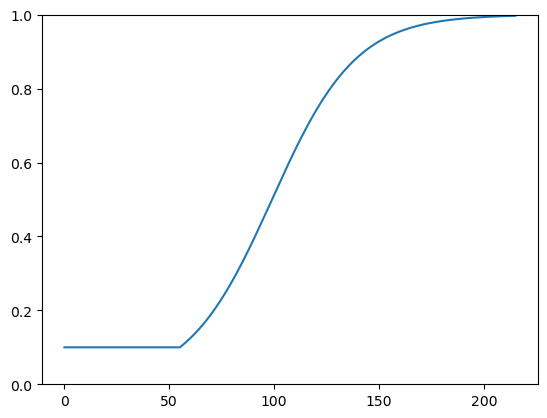

In [5]:
bereik = MLdb.train_y.shape[1]+1
xrange = (list(range(1,bereik)))
exp = 8
offset = 6*2
k = 0.05
weights = list(map(lambda x : max(0.1,(bereik/(1+(math.e**(-k*(x-100))))/bereik)),xrange))
pd.Series(weights).plot()
plt.ylim(0,1)

Visualize Loss

In [6]:
def visualize_loss(history, title):
    loss = history.history["loss"]
    # val_loss = history.history["val_loss"]
    epochs = range(len(loss))
    plt.figure()
    plt.plot(epochs, loss, "b", label="Training loss")
    # plt.plot(epochs, val_loss, "r", label="Validation loss")
    plt.title(title)
    plt.xlabel("Epochs")
    plt.ylabel("Loss")
    plt.legend()
    plt.show()

## Setup model

In [7]:
look_back = 1
trainY = np.array(MLdb.train_y)
# create and fit the LSTM network
model = Sequential()
model.add(Dense(MLdb.train_x.shape[1],input_shape=(MLdb.train_x.shape[1],)))
model.add(Dense(MLdb.train_x.shape[1]))
model.add(Dense(MLdb.train_x.shape[1]))
model.add(Dense(MLdb.train_x.shape[1]))
model.add(Dense(MLdb.train_x.shape[1]))
model.add(Dense(MLdb.train_x.shape[1]))
model.add(Dense(MLdb.train_x.shape[1]))
model.add(Dense(MLdb.train_x.shape[1]))
model.add(Dense(MLdb.train_x.shape[1]))

model.add(Dense(216))
model.compile(loss=tensorflow.keras.losses.MeanSquaredError(), 
    optimizer=tensorflow.keras.optimizers.Adam(
        learning_rate= 0.0001),
    loss_weights = weights
    )
# model.build(input_shape = (1,1,12))
model.summary()


Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 631)               398792    
                                                                 
 dense_1 (Dense)             (None, 631)               398792    
                                                                 
 dense_2 (Dense)             (None, 631)               398792    
                                                                 
 dense_3 (Dense)             (None, 631)               398792    
                                                                 
 dense_4 (Dense)             (None, 631)               398792    
                                                                 
 dense_5 (Dense)             (None, 631)               398792    
                                                                 
 dense_6 (Dense)             (None, 631)               3

In [8]:
def plot_scores_vs_horizon(MLdb):
    y_pred_unscaled =  pd.DataFrame(MLdb.scaler_y.inverse_transform(y_pred))
    y_pred_train_unscaled =  pd.DataFrame(MLdb.scaler_y.inverse_transform(y_pred_train))
    mape_list = []
    R2_list = []
    R2_train_list = []
    mape_list_naive = []
    R2_list_naive = []

    for i in range(0,MLdb.test_y.shape[1]-1):
        test_y = MLdb.test_y.iloc[:,i].values
        train_y = MLdb.train_y.iloc[:,i].values
        pred_y = y_pred_unscaled.iloc[:,i]
        pred_y_train = y_pred_train_unscaled.iloc[:,1]
        pred_y_naive = y_pred_naive.iloc[:,i]
        
        mape_list.append(mse(test_y,pred_y)**(1/2))
        R2_list.append(r2_score(test_y,pred_y))
        mape_list_naive.append(mse(test_y,pred_y_naive)**(1/2))
        R2_list_naive.append(r2_score(test_y,pred_y_naive))
        R2_train_list.append(r2_score(train_y,pred_y_train))

    R2_list = np.array(R2_list).clip(min=0)


    x_bereik = [(i*10+10)/60 for i in range(len(R2_list))]
    plt.plot(x_bereik,mape_list,label = 'model')
    plt.plot(x_bereik,mape_list_naive,label = 'naive')
    plt.title('MSE')
    plt.xlabel('Hours in future')
    plt.legend()
    plt.grid()
    plt.figure()
    plt.plot(x_bereik,R2_list,label = 'model_test')
    plt.plot(x_bereik,R2_train_list,label ='model_train')
    plt.plot(x_bereik,R2_list_naive, label = 'naive')
    plt.title('R2')
    plt.xlabel('Hours in future')
    plt.legend()
    plt.grid()
    plt.figure()


Hij ziet er net iets anders uit vanwege dat ik een andere testset heb (alleen 2020+)

## Load model

> Another saving technique is `model.save(filepath)`. This save function saves:
>
>    The architecture of the model, allowing to re-create the model.
>    The weights of the model.
>    The training configuration (loss, optimizer).
>    The state of the optimizer, allowing to resume training exactly where you left off.

[_blackHoleDetector on Stack Overflow_](https://stackoverflow.com/a/47271117)

In [9]:
model = keras.models.load_model('NN.h5')
model.history

In [10]:
MLdb.model = model
MLdb.create_predictions(dataset='all')

y_pred_train = pd.DataFrame(model.predict(MLdb.train_x))
y_pred = pd.DataFrame(model.predict(MLdb.test_x))

9486/9486 [==============================] - 86s 9ms/step


In [11]:
MLdb.y_pred_df

,0,1,2,3,4,5,6,7,8,9,...,206,207,208,209,210,211,212,213,214,215
datetime,,,,,,,,,,,,,,,,,,,,,
2016-01-01 00:00:00,2.048432,2.054508,2.060228,2.043731,2.061744,2.034716,2.021171,2.055107,2.050153,2.044294,...,1.453847,1.456532,1.476730,1.482193,1.505750,1.514235,1.524989,1.498029,1.519045,1.495607
2016-01-01 00:10:00,2.068621,2.072211,2.079541,2.064273,2.080446,2.056522,2.048917,2.082637,2.080725,2.079633,...,1.521279,1.524454,1.544484,1.548995,1.565276,1.577108,1.579805,1.553321,1.575240,1.545752
2016-01-01 00:20:00,2.064850,2.071712,2.084273,2.070302,2.085099,2.067453,2.061919,2.093771,2.094643,2.093260,...,1.527319,1.534515,1.554262,1.557511,1.575074,1.587190,1.588812,1.567953,1.587729,1.561335
2016-01-01 00:30:00,2.067737,2.078955,2.098319,2.091452,2.108027,2.096613,2.091258,2.126633,2.130357,2.131926,...,1.543566,1.551312,1.573347,1.575478,1.592811,1.606639,1.609984,1.586943,1.606941,1.581976
2016-01-01 00:40:00,2.084781,2.096956,2.116731,2.107987,2.128577,2.109471,2.105986,2.138994,2.141588,2.142146,...,1.566282,1.571309,1.594405,1.595382,1.614459,1.629422,1.633523,1.613109,1.631066,1.608398
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-07-03 01:00:00,2.658808,2.754056,2.728978,2.810258,2.841383,3.011106,3.008662,3.084769,3.089272,3.270036,...,4.216669,4.245002,4.187291,4.074532,4.169117,4.119579,4.078603,4.058345,4.100329,4.048549
2022-07-03 01:10:00,2.690048,2.761450,2.716826,2.789361,2.811505,2.968306,2.952788,3.026189,3.028288,3.204109,...,4.205667,4.254975,4.204425,4.114164,4.226297,4.201937,4.180038,4.187468,4.242641,4.219509
2022-07-03 01:20:00,2.646222,2.719488,2.672898,2.756450,2.781636,2.940334,2.920773,2.995198,2.992929,3.163093,...,4.233504,4.285565,4.221694,4.134679,4.242030,4.208330,4.193795,4.211905,4.254138,4.235469


Show whether values are logical:

<Axes: >

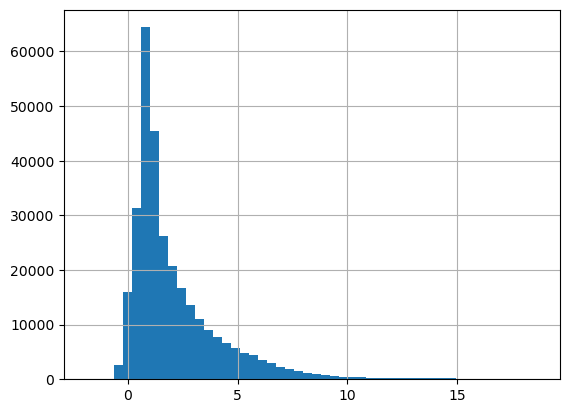

In [21]:
MLdb.y_pred_df.iloc[:,0].hist(bins=50)

Better column names

In [12]:
MLdb.y_pred_df.columns = (MLdb.y_pred_df.columns+1)*datetime.timedelta(minutes=10)

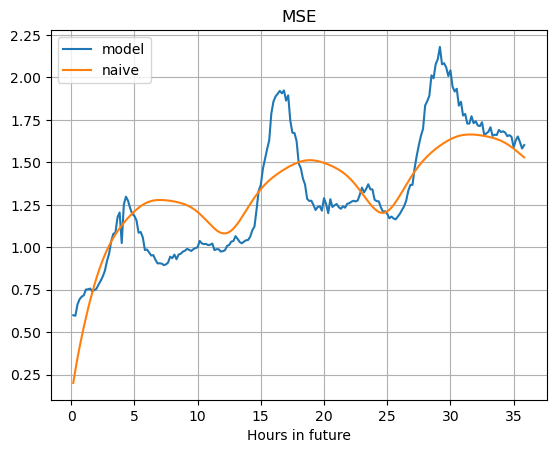

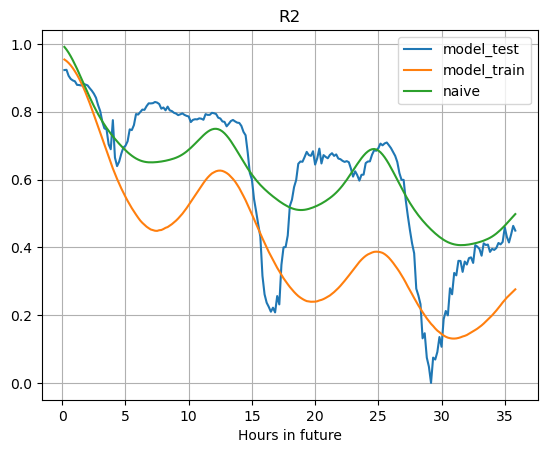

<Figure size 640x480 with 0 Axes>

In [13]:
plot_scores_vs_horizon(MLdb)

Create dataframes:

In [14]:
predictions_export = MLdb.index_predictions_to_horizon_time()
predictions_export_light = predictions_export.iloc[:,[2,5,11,23,35,47,71,107,143,215]]

Save dataframes:

In [15]:
pred_exp_folder = fr"C:\Users\{getpass.getuser()}\OneDrive - Hoogheemraadschap van Delfland\3_Projecten\Zoutindringing\Data\voorspellingen\voorsp_2023_07_20"
predictions_export.to_csv(fr"{pred_exp_folder}/voorspellingen_egv_parkhaven_all.csv")
predictions_export_light.to_csv(fr"{pred_exp_folder}/voorspellingen_egv_parkhaven_light_all.csv")


Export real values:

In [30]:
MLdb.test_y.iloc[:,0].shift(1).to_csv(fr"{pred_exp_folder}/metingen_egv_parkhaven_all.csv")

In [16]:
break

SyntaxError: 'break' outside loop (668683560.py, line 1)

In [ ]:
MLdb.get_random_date()

Timestamp('2018-08-28 16:20:00')

In [ ]:
MLdb.predict_window2(MLdb.get_random_date())

In [ ]:
rows = 10
cols = 3
yscale = 1
xscale = 2

fig, ax = plt.subplots(nrows=rows, ncols=cols)

for row in range(rows):
    for col in range(cols):
        startdate = MLdb.get_random_date('test')
        comp = MLdb.predict_window2(past = 2,startdate = startdate)
        plot = comp.plot(ax = ax[row,col], legend = False,x_compat = True)

        plot.set(xlabel=None)
        # plot.xaxis.get_ticklocs(minor=True)
        plot.set_title(str(startdate))
        # plot.minorticks_on()
        plot.xaxis.set_minor_locator(ticker.AutoMinorLocator(6))
        plot.xaxis.set_major_formatter(matplotlib.dates.DateFormatter('%m-%d \n%H:%M:%S'))


        plot.tick_params(axis='x',labelsize = 10,labelrotation= 90)
        plot.grid(which = 'both')
        plot.axvline(startdate,color = 'red',alpha = 0.5)

plt.subplots_adjust(hspace=0.4)
plt.show()


In [ ]:
MLdb.simulate_live(100).plot()

In [ ]:
import shap

c:\Users\Admin\Anaconda3\envs\py36_env\lib\site-packages\tqdm\auto.py:22: TqdmWarning:

IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html



In [ ]:
explainer = shap.KernelExplainer(MLdb.model, shap.sample(MLdb.train_x,1000))

Using 1000 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.


In [ ]:
X_idx = 0
shap_values = explainer.shap_values(X = MLdb.train_x.iloc[X_idx:X_idx+10,:],nsamples=100)

# X_train = MLdb.train_x
# background = X_train.iloc[np.random.choice(X_train.shape[0], 100, replace=False)]

# explainer = shap.DeepExplainer(
#     (model.layers[0].input, model.layers[-1].output), background
# )

  0%|          | 0/10 [00:00<?, ?it/s]Regressors in active set degenerate. Dropping a regressor, after 39 iterations, i.e. alpha=1.833e-03, with an active set of 17 regressors, and the smallest cholesky pivot element being 1.054e-08. Reduce max_iter or increase eps parameters.
Early stopping the lars path, as the residues are small and the current value of alpha is no longer well controlled. 151 iterations, alpha=7.147e-04, previous alpha=7.147e-04, with an active set of 28 regressors.
Regressors in active set degenerate. Dropping a regressor, after 9 iterations, i.e. alpha=3.749e-03, with an active set of 9 regressors, and the smallest cholesky pivot element being 2.107e-08. Reduce max_iter or increase eps parameters.
Regressors in active set degenerate. Dropping a regressor, after 134 iterations, i.e. alpha=8.498e-04, with an active set of 28 regressors, and the smallest cholesky pivot element being 1.825e-08. Reduce max_iter or increase eps parameters.
Regressors in active set degen

In [ ]:
shap_values[0].shape

(10, 631)

In [ ]:
# shap.summary_plot(shap_values,MLdb.train_x,feature_names=MLdb.train_x.columns)

In [ ]:
shap.initjs()
i= 200
shap.force_plot(explainer.expected_value[i], shap_values[i],feature_names=MLdb.train_x.columns)


Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations. 


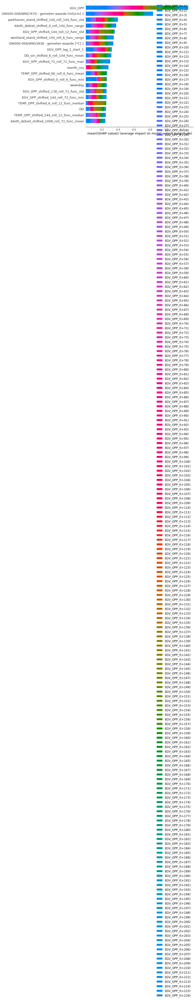

In [ ]:
shap.summary_plot(shap_values,MLdb.train_x,feature_names = MLdb.train_x.columns,class_names=MLdb.train_y.columns,class_inds=list(range(216)))

In [ ]:
# shap.waterfall_plot(explainer.expected_value,shap_values)

In [ ]:
shap.plots.force(0,np.array([i.flatten() for i in shap_values]),feature_names=MLdb.train_y.columns)

In [ ]:
for ele in range(10):
   if ele==9:
    shap.plots.force(0,np.array([i[ele] for i in shap_values]),feature_names=MLdb.train_y.columns)


In [ ]:
np.array([i[5] for i in shap_values]).shape

(216, 631)

In [ ]:
shap.save_html('SHAPLEY2.html',shap.plots.force(explainer.expected_value[0],np.array([i[0] for i in shap_values]),feature_names=MLdb.train_x.columns,figsize=(20, 9)))

In [ ]:
shap.plots.force(explainer.expected_value[0],np.array([i[9] for i in shap_values]),feature_names=MLdb.train_x.columns,figsize=(20, 9))

In [ ]:
explainer.expected_value[0]

0.15352986958995463

In [ ]:
comp = MLdb.predict_window2(startdate = MLdb.train_x.index[9])
plot = comp.plot(ax = ax[row,col], legend = False,x_compat = True)

plot.set(xlabel=None)
# plot.xaxis.get_ticklocs(minor=True)
plot.set_title(str(startdate))
# plot.minorticks_on()
plot.xaxis.set_minor_locator(ticker.AutoMinorLocator(6))
plot.xaxis.set_major_formatter(matplotlib.dates.DateFormatter('%m-%d \n%H:%M:%S'))


plot.tick_params(axis='x',labelsize = 10,labelrotation= 90)
plot.grid(which = 'both')
plot.axvline(startdate,color = 'red',alpha = 0.5)
plt.show()

<AxesSubplot:>

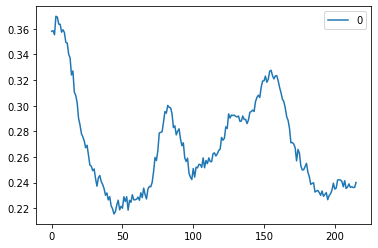

In [ ]:
pd.DataFrame(MLdb.scaler_y.transform(pd.DataFrame(comp['ypred'].T[1:]).T)[0]).plot()